In [1]:
import esm, os, json
import numpy as np
import torch
import pandas as pd
from tqdm import tqdm

In [2]:
sequences = {
    'wild_type_7khj': 'HHHMPMYEVQWKVVEESNGNNYSYIDPTQLPYDHKWEFPRNRLSFGKTLGAGAFGKVVEATAQGLIKSDAAMTVAVKMLKPSAHSTEREALMSELKVLSYLGNHENIVNLLGACTHGGPTLVITEYCCYGDLLNFLRRKRDSFHSSDTSPASMEDDENALDLEDLLSFSYQVAKGMAFLASKNCIHRDLAARNILLTHGRITKICDFGLARDIKNDSNYVDKGNARLPVKWMAPESIFNSVYTFESDVWSYGIFLWELFSLGSSPYPGMPVDSKFYKMIKEGFRMSSPEHAPAEMYDIMKTCWDADPDKRPTFKQIVQDIEKQISES',
    'T670I' : 'HHHMPMYEVQWKVVEESNGNNYSYIDPTQLPYDHKWEFPRNRLSFGKTLGAGAFGKVVEATAQGLIKSDAAMTVAVKMLKPSAHSTEREALMSELKVLSYLGNHENIVNLLGACTHGGPTLVIIEYCCYGDLLNFLRRKRDSFHSSDTSPASMEDDENALDLEDLLSFSYQVAKGMAFLASKNCIHRDLAARNILLTHGRITKICDFGLARDIKNDSNYVDKGNARLPVKWMAPESIFNSVYTFESDVWSYGIFLWELFSLGSSPYPGMPVDSKFYKMIKEGFRMSSPEHAPAEMYDIMKTCWDADPDKRPTFKQIVQDIEKQISES',
    'V560G' : 'HHHMPMYEVQWKVGEESNGNNYSYIDPTQLPYDHKWEFPRNRLSFGKTLGAGAFGKVVEATAQGLIKSDAAMTVAVKMLKPSAHSTEREALMSELKVLSYLGNHENIVNLLGACTHGGPTLVITEYCCYGDLLNFLRRKRDSFHSSDTSPASMEDDENALDLEDLLSFSYQVAKGMAFLASKNCIHRDLAARNILLTHGRITKICDFGLARDIKNDSNYVDKGNARLPVKWMAPESIFNSVYTFESDVWSYGIFLWELFSLGSSPYPGMPVDSKFYKMIKEGFRMSSPEHAPAEMYDIMKTCWDADPDKRPTFKQIVQDIEKQISES',
}

In [3]:
import esm, os, json
import numpy as np
import torch
import pandas as pd
from tqdm import tqdm

def ESM2(seqs,OUTPUT_CSV_FILE,BATCH_SIZE=32):
    model, alphabet = esm.pretrained.esm2_t33_650M_UR50D()
    batch_converter = alphabet.get_batch_converter()
    # model.cuda() # comment this back in if you have access to GPU
    model.eval()  # disables dropout for deterministic results
        
    def chunks(lst, n):
        """Yield successive n-sized chunks from lst."""
        for i in range(0, len(lst), n):
            yield lst[i : i + n]

    def call_esm_model(data_chunk):
        # torch.cuda.empty_cache() # Comment back in if you have GPU
        batch_labels, _batch_strs, batch_tokens = batch_converter(data_chunk)
        batch_lens = (batch_tokens != alphabet.padding_idx).sum(1)

        # Extract per-residue representations (on CPU)
        # batch_tokens.cuda() # If you have GPU you'll need to send tokens to cuda
        with torch.no_grad():
            results = model(batch_tokens, repr_layers=[33], return_contacts=True)
        aa_reps = results["representations"][33].detach().cpu().numpy()
        # Generate per-sequence representations via averaging
        # NOTE: token 0 is always a beginning-of-sequence token, so the first residue is token 1.
        mean_reps = []
        for i, tokens_len in enumerate(batch_lens):
            mean_reps.append(aa_reps[i, 1 : tokens_len - 1].mean(0))
        return batch_labels, mean_reps, aa_reps

    seq_col_name = "Sequence"
    rep_col_name = "ESM2 Representation"

    if os.path.exists(OUTPUT_CSV_FILE):
        df = pd.read_csv(OUTPUT_CSV_FILE, index_col=0)
    else:
        df = pd.DataFrame(seqs, columns=[seq_col_name])
        df.set_index(seq_col_name, inplace=True)
        df[rep_col_name] = np.nan

    esm2_input, mean_reps = None, None
    for chunk in tqdm(
        chunks(df, BATCH_SIZE),
        total=np.ceil(len(seqs) / BATCH_SIZE),
    ):
        if not (chunk[rep_col_name].isnull().values.any()):
            # Skip rows which we already know the ESM2 representations for
            continue
        esm2_input = [(seq, seq) for seq in chunk.index.to_numpy()]
        batch_labels, _mean_reps, aa_reps = call_esm_model(esm2_input)

        mask = df.index.isin(batch_labels) & df.columns.isin([rep_col_name])
        df.loc[mask, rep_col_name] = [
            json.dumps(
                [a.item() for a in aa_rep.reshape(aa_rep.shape[0] * aa_rep.shape[1])]
            )
            for aa_rep in aa_reps
        ]
        df.to_csv(OUTPUT_CSV_FILE)
        
    df[rep_col_name] = df[rep_col_name].apply(lambda x: np.array(json.loads(x)))

    return np.vstack(df[rep_col_name])

In [7]:
file = os.path.join(os.getcwd(),'ESM_Encoding.csv')
print(file)

c:\Users\SDL3\Documents\GitHub\ml4dd\notebooks\ESM_Encoding.csv


In [16]:
sequence_list = []
for key in sequences:
    sequence_list.append(sequences[key])

In [17]:
sequence_list


['HHHMPMYEVQWKVVEESNGNNYSYIDPTQLPYDHKWEFPRNRLSFGKTLGAGAFGKVVEATAQGLIKSDAAMTVAVKMLKPSAHSTEREALMSELKVLSYLGNHENIVNLLGACTHGGPTLVITEYCCYGDLLNFLRRKRDSFHSSDTSPASMEDDENALDLEDLLSFSYQVAKGMAFLASKNCIHRDLAARNILLTHGRITKICDFGLARDIKNDSNYVDKGNARLPVKWMAPESIFNSVYTFESDVWSYGIFLWELFSLGSSPYPGMPVDSKFYKMIKEGFRMSSPEHAPAEMYDIMKTCWDADPDKRPTFKQIVQDIEKQISES',
 'HHHMPMYEVQWKVVEESNGNNYSYIDPTQLPYDHKWEFPRNRLSFGKTLGAGAFGKVVEATAQGLIKSDAAMTVAVKMLKPSAHSTEREALMSELKVLSYLGNHENIVNLLGACTHGGPTLVIIEYCCYGDLLNFLRRKRDSFHSSDTSPASMEDDENALDLEDLLSFSYQVAKGMAFLASKNCIHRDLAARNILLTHGRITKICDFGLARDIKNDSNYVDKGNARLPVKWMAPESIFNSVYTFESDVWSYGIFLWELFSLGSSPYPGMPVDSKFYKMIKEGFRMSSPEHAPAEMYDIMKTCWDADPDKRPTFKQIVQDIEKQISES',
 'HHHMPMYEVQWKVGEESNGNNYSYIDPTQLPYDHKWEFPRNRLSFGKTLGAGAFGKVVEATAQGLIKSDAAMTVAVKMLKPSAHSTEREALMSELKVLSYLGNHENIVNLLGACTHGGPTLVITEYCCYGDLLNFLRRKRDSFHSSDTSPASMEDDENALDLEDLLSFSYQVAKGMAFLASKNCIHRDLAARNILLTHGRITKICDFGLARDIKNDSNYVDKGNARLPVKWMAPESIFNSVYTFESDVWSYGIFLWELFSLGSSPYPGMPVDSKFYKMIKEGFRMSSPEHAPAEMYDIMKTCWDADPDKRPTFKQIVQDIEKQISES']

In [18]:
descriptors = ESM2(sequence_list,file)

  0%|          | 0/1.0 [00:00<?, ?it/s]C:\Users\SDL3\AppData\Local\Temp\ipykernel_12464\4200777405.py:51: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '['[0.015453910455107689, 0.04335463419556618, -0.0357893742620945, 0.003628515638411045, 0.027013704180717468, 0.066897913813591, 0.06383879482746124, -0.11470761150121689, -0.0841311365365982, 0.042455580085515976, 0.14407573640346527, 0.07793816924095154, 0.1637033075094223, 0.08334095031023026, 0.14654719829559326, 0.02449219301342964, 0.10963710397481918, -0.0533861443400383, 0.043435823172330856, -0.01702459529042244, -0.04928777739405632, -0.13820460438728333, 0.049807071685791016, 0.15975888073444366, -0.08016344159841537, 0.03115888126194477, 0.018382970243692398, -0.042528003454208374, 0.0643097311258316, -0.029690001159906387, 0.1302875578403473, 0.08536892384290695, 0.1087416335940361, 0.12742966413497925, 0.09652522206306458, 0.049254611134529114, -0.050

In [21]:
len(descriptors[0])

421120

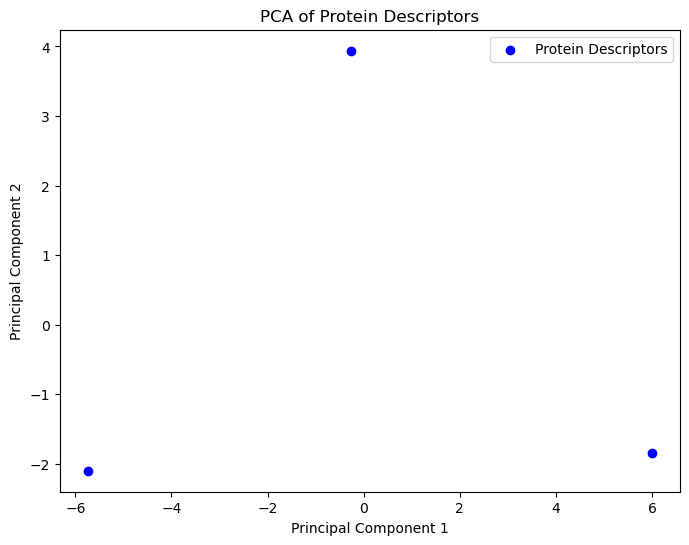

In [23]:
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Let's assume 'descriptors' is your list of 421120-dimensional vectors for three proteins
descriptors = np.array(descriptors)  # Ensure it's a numpy array

# Instantiate PCA: let's reduce the dimensions to 2 for visualization
pca = PCA(n_components=2)
reduced_descriptors = pca.fit_transform(descriptors)

# Plot the reduced descriptors to visualize differences
plt.figure(figsize=(8, 6))
plt.scatter(reduced_descriptors[:, 0], reduced_descriptors[:, 1], c='blue', label='Protein Descriptors')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of Protein Descriptors')
plt.legend()
plt.show()
